# Week 2: Playing Sound

<font size="6"> Laboratory 1 </font> <br>
<font size="3"> Last updated January 23, 2023 </font>

## <span style="color:orange;"> 00. Content </span>

<font size="5"> Mathematics </font>
- Sinusoidal functions
- Chromatic scale frequencies
- Transformations of the independent variables: time reversal and time scaling
    
<font size="5"> Programming Skills </font>
- Introduce the `Audio` display object
- Show how to make sounds from a `numpy` array
- Manipulate audio as arrays:
    - concatenation
    - reversing
    - downsampling
    - upsampling
    
<font size="5"> Embedded Systems </font>
- N/A

## <span style="color:orange;"> 0. Required Hardware </span>
- Headphones

<h3 style="background-color:lightblue"> Write your name and email below: </h3>

**Name:** Aidan Leib 

**Email:** pleib@purdue.edu

# What is a sound?

Your ears are pretty remarkable. They are very sensitive air pressure sensors. When the air pressure fluctuates at frequencies within a certain range, *sound waves* are created. Through your ears, these sound waves are transformed into electric signals that your brain interprets as sound. These sound waves can be represented by functions (or, more generally, signals). 

Let's hear an example. If you have headphones, put them on now. Then, run the following cell and press play.

In [33]:
import numpy as np
from IPython.display import Audio

t = np.linspace(0, 5, 5 * 44100)
y = np.sin(440 * 2 * np.pi * t)

Audio(y, rate=44100)

What did you just hear? Let's visualize the sound wave function using a graph.

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()
%matplotlib inline
plt.rcParams["figure.figsize"] = (8, 5)

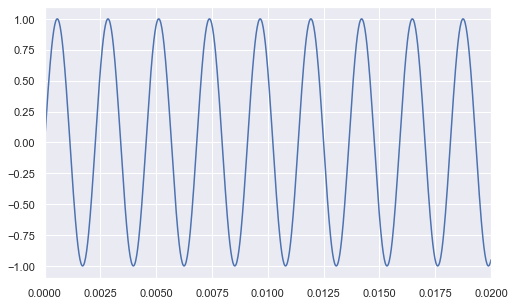

In [35]:
fig, ax = plt.subplots()
ax.plot(t, y)
ax.set_xlim(0, 0.02)
plt.show()

We can see that it is a sine wave with a frequency of 440 Hz. In music, the sound it makes is called `A`, or more specifically, `A4` or "middle A". When your ears detect air pressure changing in this pattern, you hear it as a middle A.

Let's inspect the code we just used a bit more carefully. We gave the function `Audio` two parameters, `y` and `rate`. What's in `y`?

In [36]:
y[:10]

array([0.        , 0.06264861, 0.12505109, 0.18696228, 0.24813895,
       0.30834076, 0.36733118, 0.42487847, 0.48075654, 0.53474585])

It's a list of numbers showing the air pressure at various times. The scale of the y-axis is arbitrary, your computer re-scales it to make an appropriate volume before playing the sound. The parameter `rate` simply says how often to read a new number from the list. Most digital audio equipment is set up to read 44100 numbers per second, so that's the rate we are using.

### <span style="color:red"> Exercise 1 </span>

Play an A 440Hz note for 3 seconds at a sampling rate of 44100Hz. Then Play an A 440Hz for 2 seconds at a sampling rate of 2000 Hz.

In [37]:
rate = 44100

t = np.linspace(0, 3, 3 * rate)
y = np.sin(440 * 2 * np.pi * t)

Audio(y, rate=rate)

In [38]:
rate = 2000

t = np.linspace(0, 3, 3 * rate)
y = np.sin(440 * 2 * np.pi * t)

Audio(y, rate=rate)

### <span style="color:red"> Exercise 2</span>

Consider the function $f(t)=sin(2\pi 400 t)$. What sound does it represent? 


It represnts a 400Hz sine wave.

### <span style="color:red"> Exercise 3</span>

Consider the function $f(t)=1+ sin(2\pi 400 t)$. What sound does it represent? Explain.

It also represents a 400Hz sine wave but with an increase in amplitude due to the vertical offset of 1

## A more complicated sound

The example above is quite simple, but you can actually make almost any sound this way. Let's load up a more complicated sound and have a look at it.

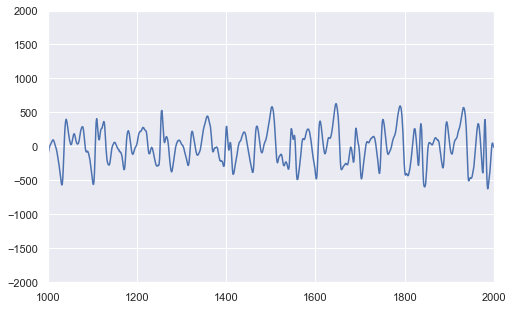

In [39]:
mystery_sound = np.loadtxt("mystery_sound.txt")
fig, ax = plt.subplots()
ax.plot(mystery_sound)
ax.set_xlim(1000, 2000)
ax.set_ylim(-2000, 2000)
plt.show()

The curve it makes is not just a sine wave. What does it sound like? 

### <span style="color:red"> Exercise 4 </span>

Use the `Audio` command to play this sound. Then, after listening to it, write down the name of the tune that plays.

In [40]:
Audio(mystery_sound, rate=44100)

The song that plays is Hail Purdue.

# Making sounds

Now that you see a sound can be expressed as a list of numbers, let's set about making our own music. We will need a way to make musical notes. To do that, we will use the **chromatic scale**. In the chromatic scale, an octave is a doubling of frequency. Also, twelve notes make up an octave and their frequencies are evenly spaced. These are the notes made by piano keys.

--------------------
Middle A has the frequency 440.00


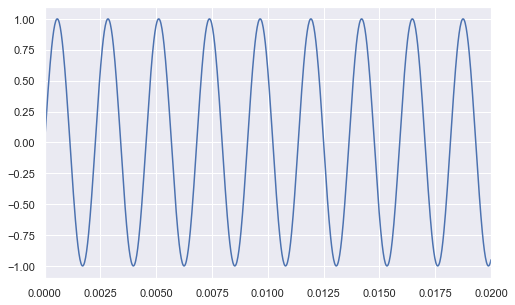

--------------------
Middle A# has the frequency 466.16


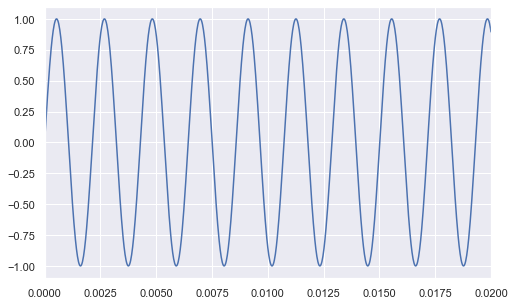

--------------------
Middle B has the frequency 493.88


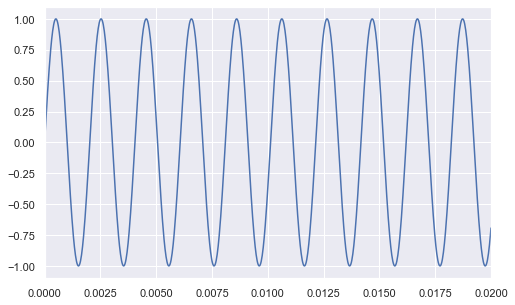

--------------------
Middle C has the frequency 523.25


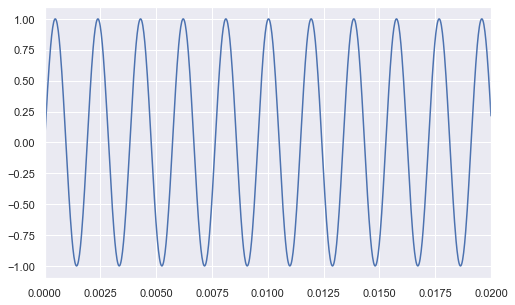

--------------------
Middle C# has the frequency 554.37


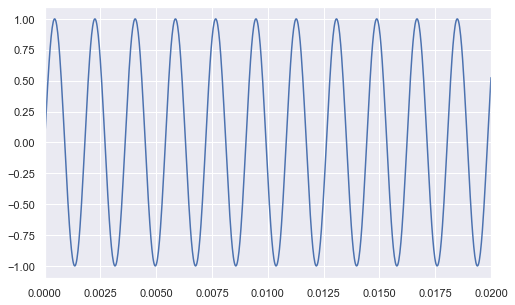

--------------------
Middle D has the frequency 587.33


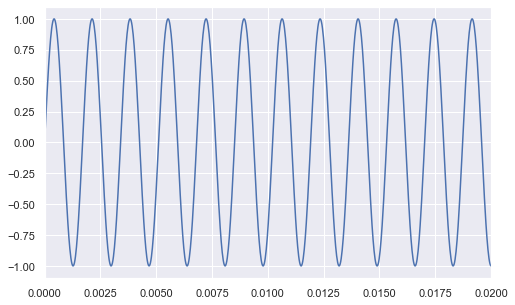

--------------------
Middle D# has the frequency 622.25


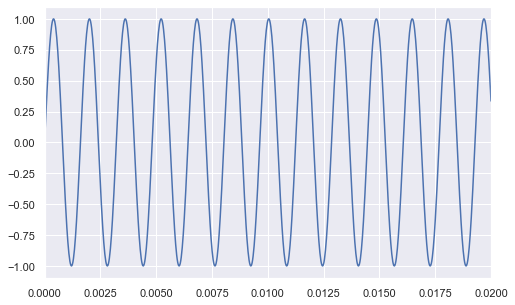

--------------------
Middle E has the frequency 659.26


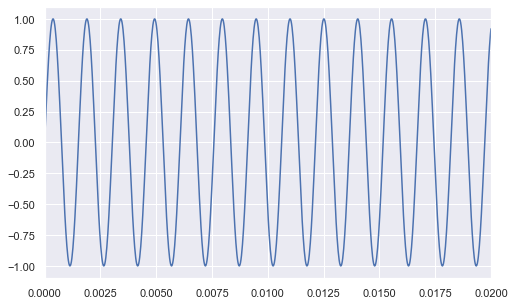

--------------------
Middle F has the frequency 698.46


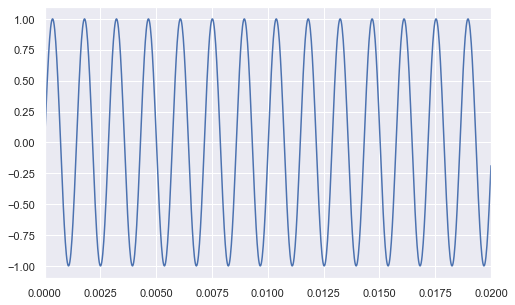

--------------------
Middle F# has the frequency 739.99


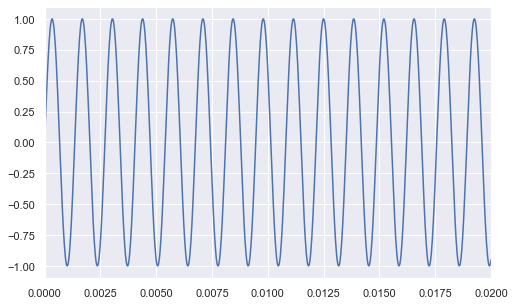

--------------------
Middle G has the frequency 783.99


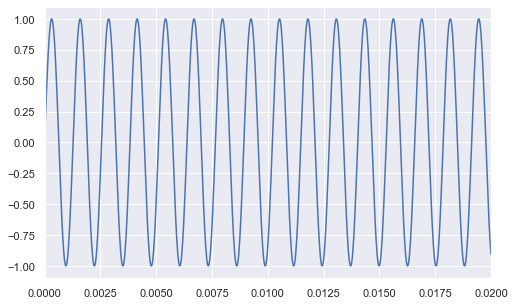

--------------------
Middle G# has the frequency 830.61


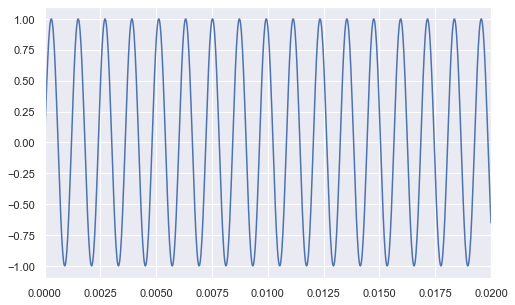

In [41]:
t = np.linspace(0, 0.5, 44100 // 2)
notes = "A A# B C C# D D# E F F# G G#"
frequencies = 440 * 2 ** (np.arange(12) / 12)
scale = dict(zip(notes.split(), frequencies))
for note, frequency in scale.items():
    print("-" * 20)
    print(f"Middle {note} has the frequency {frequency:.2f}")
    fig, ax = plt.subplots()
    y = np.sin(2 * np.pi * frequency * t)
    ax.plot(t, y)
    ax.set_xlim(0, 0.02)
    plt.show()
    display(Audio(y, rate=44100))

# Making Music

By stringing these together, we can form a song. We will use the function `np.concatenate` which stacks up arrays end-to-end. Here is the start of "Row Row Your Boat".

In [42]:
boat_notes = "C C C D E E D E F G"
boat_song = np.concatenate(
    [np.sin(2 * np.pi * scale[note] * t) for note in boat_notes.split()]
)
print(boat_song[:10])
Audio(boat_song, rate=44100)

[0.         0.07448499 0.14855616 0.22180199 0.29381555 0.36419675
 0.43255457 0.49850923 0.56169432 0.62175878]


### <span style="color:red"> Exercise 5 </span>

Here are the notes for the chorus of Hail Purdue. Play the song!
```
D#3 D#3 F3 G3 G#3 A#4 C4 C4 C#4 C#4 G#3 A#4 C4 C4 C4
```

In [43]:
upper_octave = dict(zip("A4 A#4 B4 C5 C#5 D5 D#5 E5 F5 F#5 G5 G#5".split(), list(scale.values())))
mid_octave = dict(zip("A3 A#3 B3 C4 C#4 D4 D#4 E4 F4 F#4 G4 G#4".split(), np.divide(list(upper_octave.values()), 2)))
lower_octave = dict(zip("A2 A#2 B2 C3 C#3 D3 D#3 E3 F3 F#3 G3 G#3".split(), np.divide(list(mid_octave.values()), 2)))

octaves = dict(
    zip(
        list(lower_octave.keys()) + list(mid_octave.keys()) + list(upper_octave.keys()), 
        list(lower_octave.values()) + list(mid_octave.values()) + list(upper_octave.values())
    )
)

octaves

{'A2': 110.0,
 'A#2': 116.54094037952248,
 'B2': 123.47082531403103,
 'C3': 130.8127826502993,
 'C#3': 138.59131548843604,
 'D3': 146.8323839587038,
 'D#3': 155.56349186104046,
 'E3': 164.81377845643496,
 'F3': 174.61411571650194,
 'F#3': 184.9972113558172,
 'G3': 195.99771799087463,
 'G#3': 207.65234878997256,
 'A3': 220.0,
 'A#3': 233.08188075904496,
 'B3': 246.94165062806206,
 'C4': 261.6255653005986,
 'C#4': 277.1826309768721,
 'D4': 293.6647679174076,
 'D#4': 311.1269837220809,
 'E4': 329.6275569128699,
 'F4': 349.2282314330039,
 'F#4': 369.9944227116344,
 'G4': 391.99543598174927,
 'G#4': 415.3046975799451,
 'A4': 440.0,
 'A#4': 466.1637615180899,
 'B4': 493.8833012561241,
 'C5': 523.2511306011972,
 'C#5': 554.3652619537442,
 'D5': 587.3295358348151,
 'D#5': 622.2539674441618,
 'E5': 659.2551138257398,
 'F5': 698.4564628660078,
 'F#5': 739.9888454232688,
 'G5': 783.9908719634985,
 'G#5': 830.6093951598903}

In [44]:
chromatic_scale = "A4 A#4 B4 C5 C#5 D5 D#5 E5 F5 F#5 G5 G#5"

chromo_scale = np.concatenate(
    [np.sin(2 * np.pi * octaves[note] * t) for note in octaves.keys()]
)
print(chromo_scale)
Audio(chromo_scale, rate=44100)

[0.         0.01567241 0.03134098 ... 0.99428302 0.9747209  0.94152273]


In [45]:
hail_notes = "D#3 D#3 F3 G3 G#3 A#4 C4 C4 C#4 C#4 G#3 A#4 C4 C4 C4"
hail_notes_v2 = "D4 E4 F#4 G4 A4 B4 B4 C5 C5 C5 G4 A#4 A#4 B4"

hail_purdue = np.concatenate(
    [np.sin(2 * np.pi * octaves[note] * t) for note in hail_notes_v2.split()]
)
print(hail_purdue)
Audio(hail_purdue, rate=44100)

[ 0.          0.04182983  0.08358643 ... -0.4858708  -0.42321383
 -0.35846203]


### <span style="color:red"> Exercise 6 </span>

Play the C chord (i.e. C, E and G played together at the same time). Hint: Try adding the functions for each note. 

In [46]:
t = np.linspace(0,1, 44100)

c = np.sin(2 * np.pi * octaves["C4"] * t)
e = np.sin(2 * np.pi * octaves["E4"] * t)
g = np.sin(2 * np.pi * octaves["G4"] * t)

chord = np.add(c, np.add(e, g))

Audio(chord, rate=44100)

Let us explore more about the audio array. What if we only play every other number? Let's try it with slicing.

In [47]:
faster = boat_song[::2]
print(faster[:10])
Audio(faster, rate=44100)

[0.         0.14855616 0.29381555 0.43255457 0.56169432 0.67836891
 0.77998911 0.86429975 0.9294298  0.97393389]


Now let's try dragging the notes out longer by repeating each number twice.

In [48]:
slower = np.repeat(boat_song, 2)
print(slower[:10])
Audio(slower, rate=44100)

[0.         0.         0.07448499 0.07448499 0.14855616 0.14855616
 0.22180199 0.22180199 0.29381555 0.29381555]


When we play it back faster, the song has a higher pitch but lasts half as long. When we play it back slower the song has a lower pitch and lasts twice as long. Most people find that the song is still recognizably the same when the pitch is doubled or halved, so we give a note with twice or one-half the frequency the same letter. Here is a wider scale we can use:

In [49]:
full_scale = {}
for i in range(1, 7):
    for j, letter in enumerate(notes.split()):
        full_scale[letter + str(i)] = 440 * 2 ** (i - 4 + j / 12)
full_scale

{'A1': 55.0,
 'A#1': 58.27047018976124,
 'B1': 61.7354126570155,
 'C1': 65.40639132514966,
 'C#1': 69.29565774421802,
 'D1': 73.41619197935188,
 'D#1': 77.78174593052023,
 'E1': 82.4068892282175,
 'F1': 87.30705785825097,
 'F#1': 92.4986056779086,
 'G1': 97.99885899543733,
 'G#1': 103.82617439498628,
 'A2': 110.0,
 'A#2': 116.54094037952248,
 'B2': 123.47082531403103,
 'C2': 130.8127826502993,
 'C#2': 138.59131548843604,
 'D2': 146.8323839587038,
 'D#2': 155.56349186104046,
 'E2': 164.813778456435,
 'F2': 174.61411571650194,
 'F#2': 184.9972113558172,
 'G2': 195.99771799087466,
 'G#2': 207.65234878997256,
 'A3': 220.0,
 'A#3': 233.08188075904496,
 'B3': 246.94165062806206,
 'C3': 261.6255653005986,
 'C#3': 277.1826309768721,
 'D3': 293.6647679174076,
 'D#3': 311.1269837220809,
 'E3': 329.6275569128699,
 'F3': 349.2282314330039,
 'F#3': 369.9944227116344,
 'G3': 391.99543598174927,
 'G#3': 415.3046975799451,
 'A4': 440.0,
 'A#4': 466.1637615180899,
 'B4': 493.8833012561241,
 'C4': 523.2

### <span style="color:red"> Exercise 7 </span>

Write your own song, including some chord, play it, and save the data in a text file. Exchange your text file with someone else in the class. 

In [50]:
class Note:
    rate = 44100
    bpm = 144
    
    def __init__(self, note, freq):
        self.note = note
        self.freq = freq
        self.array = np.array(None)
    
    def __repr__(self):
        return f'{self.note}: {self.freq}Hz'
        
    def play(self, length):
        bps = Note.bpm / 60
        t = np.linspace(0, length / bps, int(length * Note.rate / bps))

        array = np.sin(2 * np.pi * self.freq * t).round(2)

        return array

class Chord(Note):
    def __init__(self, name, notes):
        self.name = name
        self.notes = notes
        
    def __repr__(self):
        return f'{self.name}: {[note for note in self.notes]}'
    
    def play(self, length):
        array = [0]
        
        for note in self.notes:
            array += note.play(length)
            
        return array
            

In [51]:
notes = [
    Note(note, freq) for note, freq in full_scale.items()
]

rest = Note('rest', 0)

a1 = notes[0]
as1 = notes[1]
b1 = notes[2]
c1 = notes[3]
cs1 = notes[4]
d1 = notes[5]
ds1 = notes[6]
e1 = notes[7]
f1 = notes[8]
fs1 = notes[9]
g1 = notes[10]
gs1 = notes[11]
a2 = notes[12]
as2 = notes[13]
b2 = notes[14]
c2 = notes[15]
cs2 = notes[16]
d2 = notes[17]
ds2 = notes[18]
e2 = notes[19]
f2 = notes[20]
fs2 = notes[21]
g2 = notes[22]
gs2 = notes[23]
a3 = notes[24]
as3 = notes[25]
b3 = notes[26]
c3 = notes[27]
cs3 = notes[28]
d3 = notes[29]
ds3 = notes[30]
e3 = notes[31]
f3 = notes[32]
fs3 = notes[33]
g3 = notes[34]
gs3 = notes[35]
a4 = notes[36]
as4 = notes[37]
b4 = notes[38]
c4 = notes[39]
cs4 = notes[40]
d4 = notes[41]
ds4 = notes[42]
e4 = notes[43]
f4 = notes[44]
fs4 = notes[45]
g4 = notes[46]
gs4 = notes[47]
a5 = notes[48]
as5 = notes[49]
b5 = notes[50]
c5 = notes[51]
cs5 = notes[52]
d5 = notes[53]
ds5 = notes[54]
e5 = notes[55]
f5 = notes[56]
fs5 = notes[57]
g5 = notes[58]
gs5 = notes[59]
a6 = notes[60]
as6 = notes[61]
b6 = notes[62]
c6 = notes[63]
cs6 = notes[64]
d6 = notes[65]
ds6 = notes[66]
e6 = notes[67]
f6 = notes[68]
fs6 = notes[69]
g6 = notes[70]
gs6 = notes[71]

notes = [
    a1, as1, b1, c1, cs1, d1, ds1, e1, f1, fs1, g1, gs1, 
    a2, as2, b2, c2, cs2, d2, ds2, e2, f2, fs2, g2, gs2, 
    a3, as3, b3, c3, cs3, d3, ds3, e3, f3, fs3, g3, gs3, 
    a4, as4, b4, c4, cs4, d4, ds4, e4, f4, fs4, g4, gs4, 
    a5, as5, b5, c5, cs5, d5, ds5, e5, f5, fs5, g5, gs5, 
    a6, as6, b6, c6, cs6, d6, ds6, e6, f6, fs6, g6, gs6
]

In [52]:
hail_notes = [
    (d4,2),
    (e4,1),
    (fs4,1),
    (g4,1.5),
    (a5,.5),
    (b5,1),
    (b5,1),
    (c5,1),
    (c5,.5),
    (c5,.5),
    (g4,1),
    (a5,.5),
    (as5,.5),
    (b5,3),
    (rest,1),
    (b5,2),
    (b5,1),
    (a5,1),
    (g4,1.5),
    (a5,.5),
    (b5,1),
    (b5,1),
    (a5,1),
    (e4,.5),
    (f4,.5),
    (g4,1),
    (fs4,.5),
    (e4,.5),
    (a5,3),
    (rest,1),
    (d4,1.5),
    (d4,.5),
    (e4,1),
    (fs4,1),
    (g4,1.5),
    (a5,.5),
    (b5,1),
    (b5,.5),
    (b5,.5),
    (c5,1),
    (c5,1),
    (g4,1),
    (a5,1),
    (b5,3),
    (rest,1),
    (e4,1.5),
    (fs4,.5),
    (g4,1),
    (e4,1),
    (d4,1),
    (g4,1),
    (b5,1),
    (d4,1),
    (e4,1.5),
    (b5,.5),
    (a5,1.5),
    (g4,.5),
    (g4,3),
    (rest,1)
]

hail_compose = np.concatenate([
    note.play(l) for note, l in hail_notes
])

Audio(hail_compose, rate=44100)

In [53]:
A7 = Chord('A7', notes=[a4, cs4, e4, g4])
B7 = Chord('B7', notes=[b4, ds4, fs4, a5])
C = Chord('C', notes=[c4, e4, g4])
Cm = Chord('Cm', notes=[c4, cs4, g4])
D7 = Chord('D7', notes=[d4, fs4, a5, c5])
Em = Chord('Em', notes=[e4, g4, b5])
E7 = Chord('E7', notes=[e4, gs4, b5, d5])
G = Chord('G', notes=[g4, b5, d5])
G7 = Chord('G', notes=[g4, b5, d5, f5])
D7 = Chord('D7', notes=[d4, fs4, a5, c5])

hail_chords = [
    (G,2),
    (D7,2),
    (G,2),
    (G7,2),
    (C,2),
    (Cm,2),
    (G,3),
    (rest,1),
    (B7,4),
    (Em,4),
    (A7,4),
    (D7,3),
    (rest,1),
    (G,2),
    (D7,2),
    (G,2),
    (G7,2),
    (C,4),
    (B7,3),
    (rest,1),
    (C,4),
    (G,2),
    (E7,2),
    (A7,2),
    (D7,2),
    (G,3),
    (rest,1)
]

hail_chords_comp = np.concatenate([
    chord.play(l) for chord, l in hail_chords
])

Audio(hail_chords_comp, rate=44100)

In [65]:
hail_compose_2 = np.concatenate([
    hail_compose,
    [0] * (len(hail_chords_comp) - len(hail_compose))
])

hail_complete = (hail_compose_2 + hail_chords_comp * .75).round(2)

Audio(hail_complete, rate=44100)

In [66]:
with open("./my_song.txt", "w") as fid:
    for line in hail_complete:
        fid.write(f'{line}\n')

### <span style="color:red"> Exercise 8 </span>

Play the file you received from your colleague once forward and once backward. 

In [56]:
with open("rvonters_song.txt", "r") as fid:
    new_song = [float(val) for val in fid.readlines()]

In [57]:
print(new_song[:10])

Audio(new_song, rate=44100)

[0.0, 0.16847712697372547, 0.3362634848827397, 0.5026716011416413, 0.6670205795209414, 0.8286393469041731, 0.9868698505801176, 1.1410701899807107, 1.2906176671143768, 1.4349117403651315]


In [58]:
reverse = new_song.copy()
reverse.reverse()

print(reverse[:10])

Audio(reverse, rate=44100)

[-1.6303896273971745, -1.6558871795272858, -1.6754298360514157, -1.6890615636805213, -1.6968513255635433, -1.6988922054378248, -1.695300418212476, -1.6862142142007117, -1.6717926847461455, -1.6522144774632168]


### <span style="color:red"> Exercise 9 </span>

Let f(t) be a function representing a sound wave. What function g(t) represents the sound wave played backward? 

$$g(t) = f(-t)$$

### <span style="color:red"> Exercise 10 </span>

Musicians often speed up or slow down their music for an artistic effect. The file `chipmunk.txt` has an excerpt from The Chipmunk Song by Ross Bagdasarian. Make a slowed-down version so you can hear what he sounded like while recording the voices of the chipmunks.

``` https://madmusic.com/samples/a/l/Alvin_+_The_Chipmunks_-_Chipmunk_Song_(Christmas_Don't_Be_Late).mp3
```

In [59]:
chipmunk = np.loadtxt("chipmunk.txt")
Audio(chipmunk, rate=44100)

In [60]:
slow = np.repeat(chipmunk, 2)

Audio(slow, rate=44100)

### <span style="color:red"> Exercise 11 </span>

Let f(t) be a function representing a sound wave. What function $g(t)$ represents the sound wave played twice as slow? 

$$g(t) = f(\frac{1}{2}t)$$

## <span style="color:green;"> Reflection </span>

Do not skip this section! It will be graded but only on completion.

__1. What parts of the lab, if any, do you feel you did well? <br>
2. What are some things you learned today? <br>
3. Are there any topics that could use more clarification? <br>
4. Do you have any suggestions on parts of the lab to improve?__

<h3 style="background-color:lightblue"> Write Answers for the Reflection Below </h3>

1. I think understanding how the frequencies and notes in songs work was easy to understand for me and I did a nice job implementing a class for "composing" songs.

2. I learned a lot about how audio is processed in python, I didn't realize how easy it was to manipulate arrays and change the sound.

3. For me I think I'm good, but I would imagine many people probably struggle with understanding chord structures and might just trough notes on top of each other. However this is a difficult topic to understand anyway.

4. I think maybe if you could explain the best approach to building a class/functions to make writing songs and etc. easier, that would be very helpful. I spent a lot of time trying different things to make my life easier once I got to the song composition sections.